In [1]:
import numpy as np
import librosa
import pandas as pd
import glob
import scipy
import os
import random

import librosa.display
import IPython.display as ipd

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D, Activation



import matplotlib.pyplot as plt
from matplotlib import cm

# plt.rcParams.update({
#     "lines.color": "white",
#     "patch.edgecolor": "#0f0f0fff",
#     "text.color": "white",
#     "axes.facecolor": "#0f0f0fff",
#     "axes.edgecolor": "lightgray",
#     "axes.labelcolor": "white",
#     "xtick.color": "white",
#     "ytick.color": "white",
#     "grid.color": "lightgray",
#     "figure.facecolor": "#0f0f0fff",
#     "figure.edgecolor": "#0f0f0fff",
#     "savefig.facecolor": "#0f0f0fff",
#     "savefig.edgecolor": "#0f0f0fff",
# })



from skimage.io import imshow
from sklearn.model_selection import train_test_split

import tensorflow as tf

from keras.models import Model, load_model
from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from keras.layers.core import Lambda, RepeatVector, Reshape
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D
from keras.layers.merge import concatenate, add
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.optimizers import Adam

Using TensorFlow backend.


# Import audio files

We'll get our train and test data directly from raw mp3 files. We'll get 1D numpy arrays and the constant sample rate (previously defined) by importing it with the `librosa.load` function. For this matter, in order to easen the task, we created a little function `import_audio_file()` which only returns the audio signal, since the sample rate is always the same 22050 samples/second. We're defining this constant to be used throughout the project:

In [2]:
SR = 22050

In [3]:
def import_audio_file(audiopath):
    ''' 
    Load audio file in path and transforms into Numpy array shape (1,)
    
    '''
    audio, sr = librosa.load(audiopath)
    return audio

We can hear a test:

In [4]:
sample_audio = import_audio_file('Songs/eyeofthetiger/Drums.mp3')

ipd.Audio(sample_audio, rate = SR)

We also created a function to retrieve the duration of the song in seconds:

In [5]:
def track_length_seconds(audiofile):
    '''
    Returns the lenght in seconds of a numpy array audio track
    '''
    
    return round(librosa.core.get_duration(y=audiofile), 2)

In [6]:
track_length_seconds(sample_audio)

260.08

Also, we defined a function to be able to trim the files easily by seconds:

In [7]:
def trim_audio(audio, start, stop, sr= 22050):
    '''
    Returns audio trimmed in seconds selection, from start to stop
    '''
    
    audio = audio[sr * start: sr * stop]
    
    return audio


With IPython we can easily reproduce our audio files:

In [8]:
sample = trim_audio(sample_audio, start= 40, stop= 50)

ipd.Audio(sample, rate= SR)

# Quick introduction to audio

In order to understand our approach we'll need to know the basics of digital audio signals:

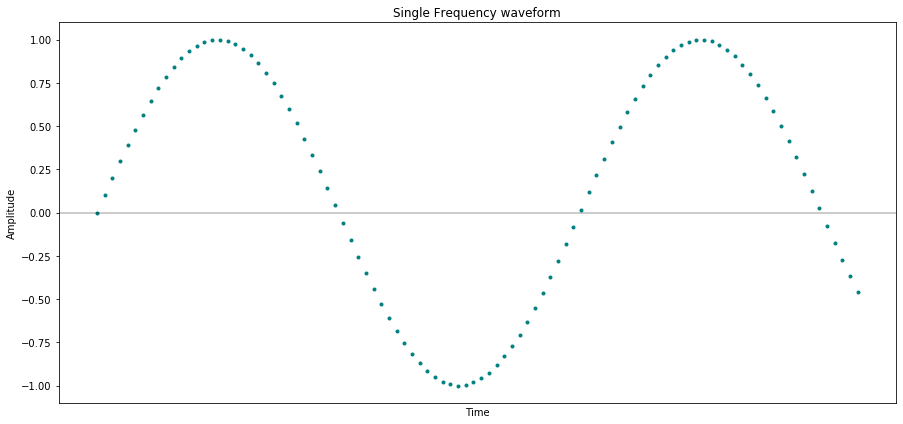

In [9]:
time= np.arange(0, 10, 0.1);
amplitude= np.sin(time)

fig, ax = plt.subplots(figsize=(15, 7))
ax.plot(time, amplitude, '.', c='teal')


ax.tick_params(
    axis='x',          # changes apply to the x-axis
    which='major',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

plt.title('Single Frequency waveform')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.xticks(None)

# plt.grid(True, which='both')
ax.axhline(y=0, color='black', linewidth=0.4)

plt.savefig('Single frequency waveform')

plt.show()

This is the aspect of a single frequency waveform. The y-axis represent its amplitude (energy in an instant of time). Because sound is a vibration, the amplitude range goes from -1 to 1, but in both cases its energy is equal.

The dots represent the samples (single value), and the x-axis represent the time.

In this signal, a single second contains 22050 samples.

Our goal is to identify this frequencies in order to capture them. The frequency is measured by the time it completes a full cycle (Hz). By looking into the plot, this might seem an easy task.

But in RealWorld™, humans can hear frequencies from 20 to 20KHz  *(yea, right!)* and all this frequencies are mixed up in the same axis of time:

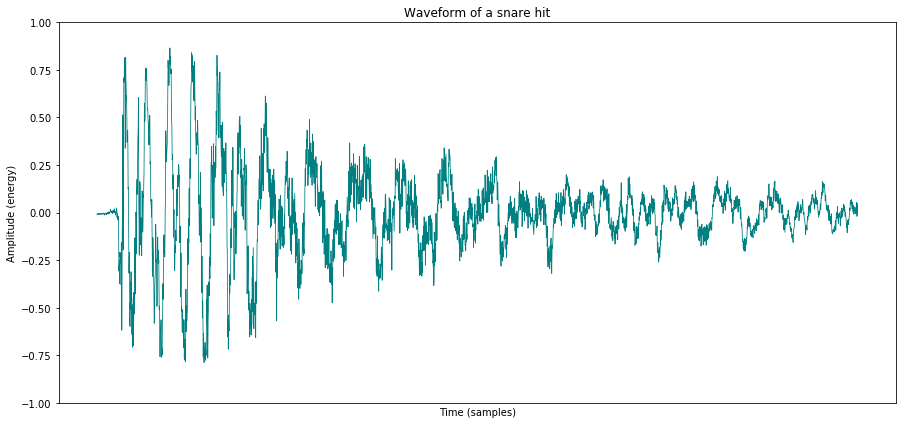

In [10]:
fig = plt.figure(figsize=(15, 7))

plt.plot(sample[7300:11000], linewidth= 0.8, c='teal')
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='major',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

plt.xlabel("Time (samples)")
plt.ylabel("Amplitude (energy)")
plt.title('Waveform of a snare hit')
plt.savefig('Waveform of a snare hit.png')
plt.ylim(-1,1)
plt.show()


In this (real) audio waveform we see a mixture of nearly 20000 frequencies on the same axis. How to identify them?

Spectrogram is a visual representation of the audio which, through a series of processes, collects information for all audio characteristics (frequency, amplitude and phase) into a single image.

# Creating Spectrogram


Our approach for this model will be transforming our 1D audio signal into a 2D image without losing **much** information (you'll understand the bold statement in a moment). This can be done through the following process:

## Short-Time Fourier Transform

The Short-time Fourier transform (STFT), is a Fourier-related transform used to determine the sinusoidal frequency and phase content of local sections of a signal as it changes over time [(Wikipedia)](https://en.wikipedia.org/wiki/Short-time_Fourier_transform#:~:text=The%20Short%2Dtime%20Fourier%20transform,as%20it%20changes%20over%20time.).

For a full understanding of the Fourier Transform you can check this [video by 3blue1brown](https://www.youtube.com/watch?v=spUNpyF58BY).

In a few words, we'll be recognizing and grouping each frequency in our signal by a time window (hop). This time window is a nº of samples (usually 512) the function needs to properly 'print' the value of each frequency in a 2D plane. In the process, we lose some information about each individual sample phase and amplitude (hence the **some** statement), but for our prupose this loss is acceptable since we'll be using a shorter time window of 512 samples.

The result is that we get something similar to the following plot, in which the x-axis is now the frequency, and the y-axis is the computed sum of the amplitude (power) of each one: 



<Figure size 1080x720 with 0 Axes>

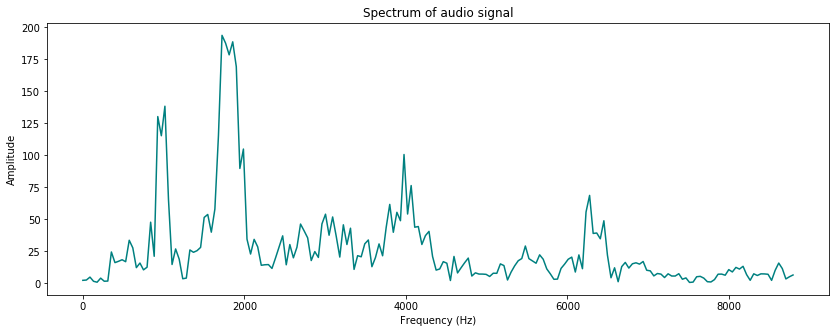

In [11]:
fig = plt.figure(figsize=(15, 10))


X = scipy.fft(sample[7300:12000])
X_mag = np.absolute(X)
f = np.linspace(0, 22050, 500)

plt.figure(figsize=(14, 5))
plt.plot(f[:200], X_mag[:200], c='teal')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.title('Spectrum of audio signal')
plt.savefig('Spectrum of audio signal.png')

plt.show()


This representation is called the **spectrum** of a sound. Represents the timbrical characteristics of a sound in a time window.

Note that the y-axis is no longer negative. This is because in this transformation the phase of each frequency is computed in the time window. This is important because in this representation the phase is taken in account for each 'frame' (or group of samples) in a 2D plane so we'll be able to reproduce it in the following step.

## Spectrogram

The spectrogram is a representation of the sound in a 2D plane, in which amplitude and frequency are embodied over time. Taking the spectrum of a sound, we'll map the amplitude of each frequency in a color-scale:

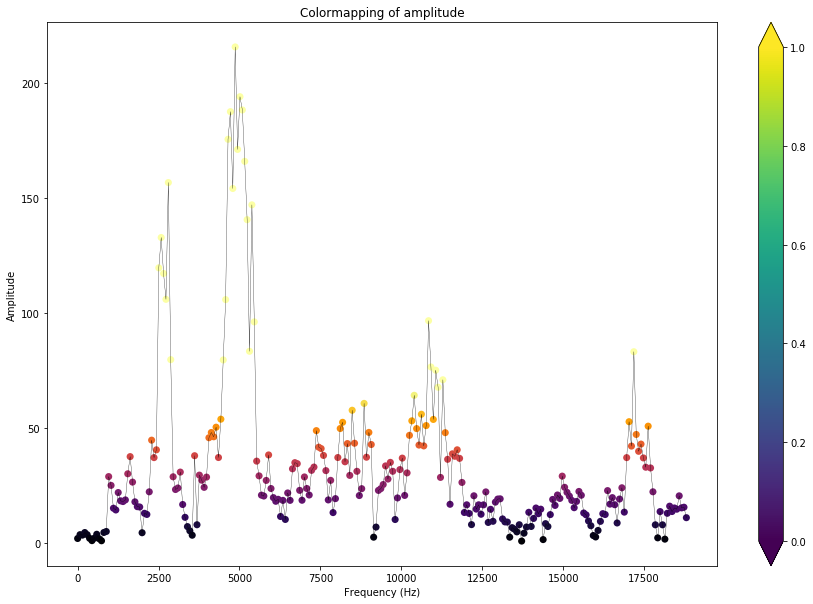

In [12]:
X = scipy.fft(sample[7300:15000])
X_mag = np.absolute(X)
f = np.linspace(0, 22050, 300)  # frequency variable

norm = plt.Normalize(0, 200)

plt.figure(figsize=(15, 10))
plt.scatter(f[:256], X_mag[:256], c=cm.inferno(X_mag[:256] *0.015), 
            edgecolor='none', 
            norm=norm, 
            s= 50, marker='o')

plt.colorbar(extend='both')

plt.plot(f[:256], X_mag[:256], c='black', linewidth = 0.3)

plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.title('Colormapping of amplitude')
plt.savefig('Colormapping.png')
plt.show()


By generating a series of spectrums, stacking them in the X-axis and plotting its color value on the y-axis, we end up with a spectrogram:

![](https://i.makeagif.com/media/3-10-2016/I0DtmH.gif)

And this is the looks of our static spectrogram:

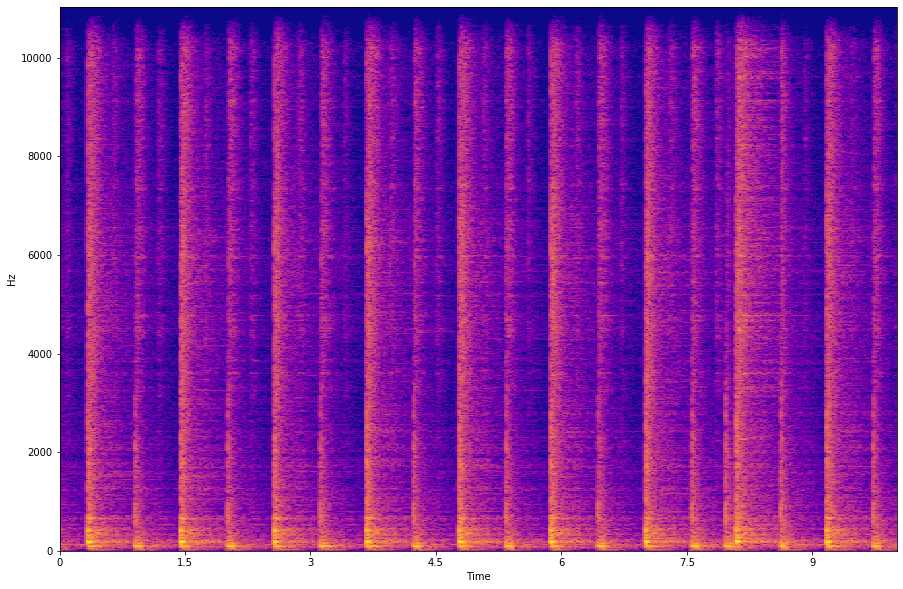

In [13]:
X = librosa.stft(sample)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(15, 10))
librosa.display.specshow(Xdb, sr=SR, x_axis='time', y_axis='hz', cmap='plasma')
plt.savefig('Spectrogram.png')
plt.show()


Now, we've managed to condense our mp3 file onto an static 2D image. With this solution, we'll try to create a neural network capable of comparing the spectrogram of a mixed song, and generate the spectrogram of the instrument we want to extract.

The last step will be adapting the frequencies into mel-scale. The errors produced in the high frequencies can be easily neglected, but become extremely problematic in low frequencies due to human sensibility to this range of frequencies. This is why we transform the scale giving more space (think in a log scale) to the low frequencies to be more represented (thus, more accurate).

Additional info can be seen [here](http://kom.aau.dk/group/04gr742/pdf/MFCC_worksheet.pdf).

# Audio-to-Spectrogram-to-Audio

Before processing the images into our convolutional neural network, we want to test the loss of the quality we experiment on the conversion from audio to image to audio. To be able to train our model, we need the shape of our image arrays to be divisible by 32.

In [14]:
valid_shapes = [num*32 for num in range(50)]
print(valid_shapes)

[0, 32, 64, 96, 128, 160, 192, 224, 256, 288, 320, 352, 384, 416, 448, 480, 512, 544, 576, 608, 640, 672, 704, 736, 768, 800, 832, 864, 896, 928, 960, 992, 1024, 1056, 1088, 1120, 1152, 1184, 1216, 1248, 1280, 1312, 1344, 1376, 1408, 1440, 1472, 1504, 1536, 1568]


Importing test audio file:

In [15]:
test = import_audio_file('songs/eyeofthetiger/mix.mp3')


After lots of experimentation, we find out thet the array shape wich works better for our model, in terms of performance, quality and efficiency is **(1024 mel-bins, 640 time-window)**.
For this matter, the number of samples we need for having a nearly 15sec sample and respect this structure is **327500 samples**:

Transformation of our audio files in Spectrogram 2D array format:

In [16]:
def mel_15s(audio, mels= 512, SAMPLES = 327500, db= False):
    '''
    Function that transforms an audio file to a spectrogram with a fixed ~15sec window.
    Input =     type Array(1,)
    Output =    type Array(mels, 640)
    
        args:
          audio = selected audio file to process
          
          mels = nº of bins in which the frequency scale is transformed
          
          SAMPLES = Constant number of samples of the length of the audio array
          
          db = If True, applies scale on amplitude values (10*log10(x)). Recommended for
               better spectrogram visualization.
    '''
    
    # Trimming the audio file:
    
    start = 0
    end = start + SAMPLES
    
    track = audio[start : end]    
    
    # Conversion to mel-spectrogram
    
    mel_amp = librosa.feature.melspectrogram(y=track, n_mels=mels, 
#                                              n_fft=2048, hop_length=512,
#                                             center=True, pad_mode='reflect'
                                            )
    
    # Apply db scale on values
    
    if db:
        mel_amp = librosa.power_to_db(mel_amp, amin=1e-10, top_db= 80.0)
    
    else:
        return mel_amp
    
    print(f'Spectrogram generated')
    
    return mel_amp


In [17]:
mel_test = mel_15s(test)

In [18]:
print(f'Shape validation: ({mel_test.shape[0]}, {mel_test.shape[0] in valid_shapes}), ({mel_test.shape[1]}) {mel_test.shape[1] in valid_shapes})')


Shape validation: (512, True), (640) True)


Let's check out the looks of our mel-spectrogram:

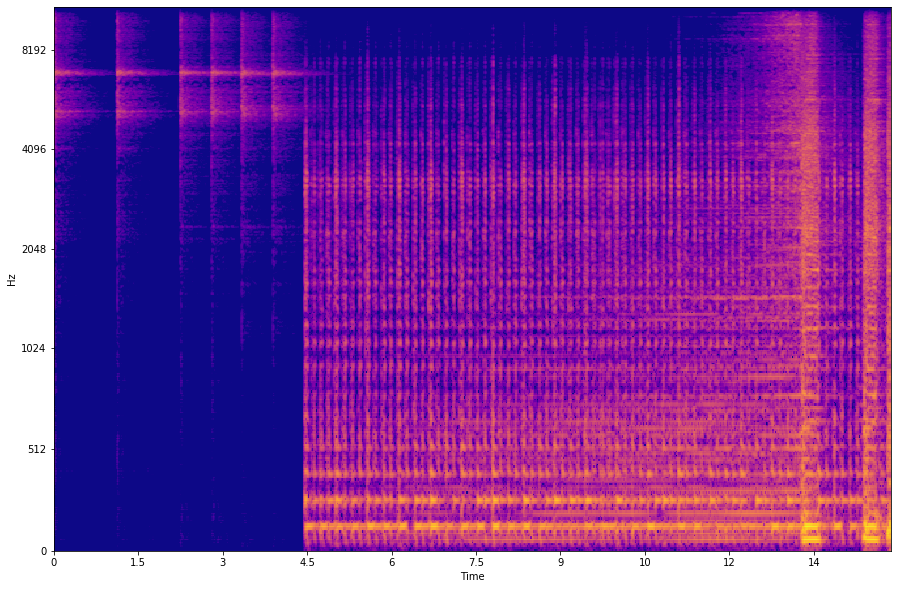

In [19]:
plt.figure(figsize=(15, 10))
librosa.display.specshow(librosa.power_to_db(mel_test, amin=1e-10, top_db= 80.0), sr=SR, x_axis='time', y_axis='mel', cmap='plasma')
# plt.show()

We'll define a function to convert mel-spectrograms to audio. This function uses the Griffin-Lim algorith for phase reconstruction. You can learn more about this algorithm [here](https://www.groundai.com/project/deep-griffin-lim-iteration/1).

In [20]:
def mel_to_audio(mel, db= False):
    ''' 
    Function that transforms a mel-spectrogram into an audio file.
    Input =     type Array(mels, 640)
    Output =    type Array(n_samples,)
    
        args:
          mel = spectrogram to process
          
          db = If True, applies inverse log scale on amplitude values (10**(db/10)).
    '''
    
    if db:
        mel = librosa.core.db_to_power(mel, ref=mel.min())

    audio = librosa.feature.inverse.mel_to_audio(mel, 
#                                                 n_fft=2048, hop_length=512, 
#                                                 window='hann', center=True, pad_mode='reflect', 
#                                                 power=2.0, n_iter=32
                                               )
    return(audio)

Turning back to audio to hear and analyze quality loss:

In [21]:
test_converted = librosa.feature.inverse.mel_to_audio(mel_test)

In [22]:
ipd.Audio(test_converted, rate= SR)

We can see that we have some loss in the audio signal due to the conversion:

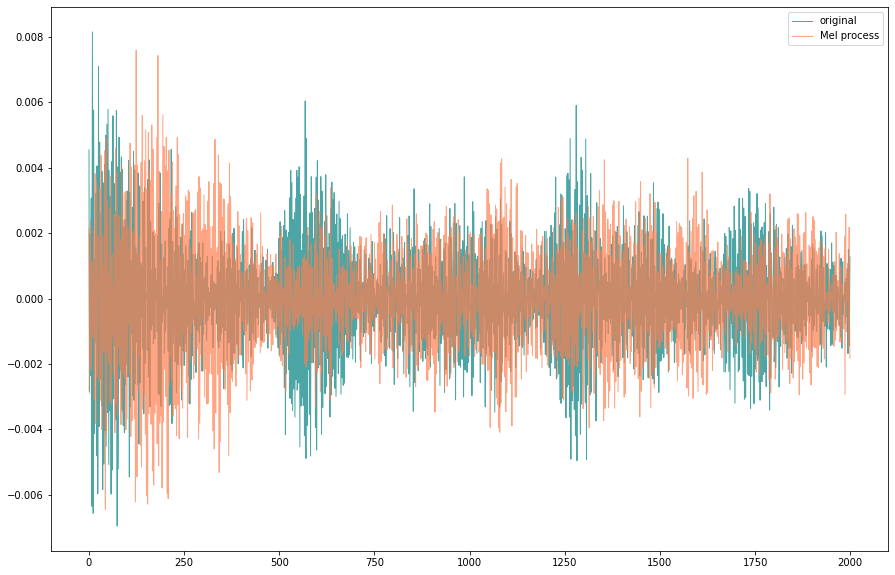

In [23]:
plt.figure(figsize=(15, 10))

plt.plot(test[10000:12000], c='teal', alpha= 0.7, linewidth=1)
plt.plot(test_converted[10000:12000], c='coral', alpha= 0.7, linewidth=1)

plt.legend(['original', 'Mel process'])

plt.savefig('mel-reconstruction.png')

We see that the signal is highly transformed, but in our hearing test the results are not bad, it preserves most of the sound quality.

For now, this loss of quality is something we can afford. We'll proceed to create a function to automate the process of getting mel-spectrograms for some files:

# Prepare data for model

As we said earlier, we need our data shape to be divisible by 2 due to the reduction the CNN is performing.

In order to automate the data import in our particular case, we define a function to load all the mp3 files in our organized multitrack folders. This way, we can also arrange them in a pandas dataframe for further organization:

In [24]:
def mix_inst_tracks(filepath = '/Users/Sosa/Repos/project-final/your-project/Songs', 
                      mels= 512, song_sections= 1, n_songs = 1, instrument = 'Drums', start_sec= 30, SAMPLES = 327500):   
    ''' 
    Function that looks up in a structured folder (path/song/audiofile.mp3) and returns 
    n song sections in mel-spectrogram array.  
    Input = type String. Path for song folders
    Output = mix_array, inst_array type Array. Shape (n_songs*song_sections, mels, 640, 1)
    
        args:
            filepath = type STR. Path where the song folders are stored
              mels = type INT. nº of bins in which the frequency scale is transformed
              song_sections = type INT. nº of spectrogram arrays to generate for each song (evenly divided in song lenght)
              n_songs = type INT. nº of song folders to generate arrays in
              instrument = type STR. Instrument to process in inst_array. This string must be the name of the file
              SAMPLES = type INT. Constant number of samples to get 15s sample and respect model structure
              start_sec = type INT. Set a start second to extract the sample of (to avoid intros)
    '''
    
    mix_arr_list = []
    inst_arr_list = []
    
    song_folders = os.listdir(filepath)
    
    for song in song_folders[:n_songs]:
        if '.' in song:
            pass
        else:
            path = filepath + '/' + song
            song_folders = os.listdir(path)
            print(f'Song: {song} \n')
            if '.' in song:
                pass
            else: 
                for track in song_folders[:n_songs]:
                    
                    a = import_audio_file(filepath + '/' + song + '/mix.mp3')
                    b = import_audio_file(filepath + '/' + song + '/' + instrument + '.mp3')
                                
                if song_sections == 1:
                    start= start_sec * 22050
                    mix_arr_list.append(mel_15s(a[start:start+SAMPLES],
                                                    mels= mels, db=True))
                    print(f'Mix track section for {song}')
                    inst_arr_list.append(mel_15s(b[start:start+SAMPLES],
                                                    mels= mels, db=True))
                    print(f'{instrument} track section for {song}')
                else:
                    start = 0
                    divided = round(a.shape[0] / song_sections)  
                    sample_index = [0 + divided*n for n in range(song_sections)]
                    print(sample_index)
    
                    for i, n in enumerate(sample_index):
                        mix_arr_list.append(mel_15s(a[n:n+SAMPLES],
                                                    mels= mels, db=True))
                        print(f'Mix track section {i}/{len(sample_index)} for {song}')
                        inst_arr_list.append(mel_15s(a[n:n+SAMPLES],
                                                    mels= mels, db=True))
                        print(f'{instrument} track section {i}/{len(sample_index)} for {song}')
                        
                        
    mix_array = np.asarray(mix_arr_list)
    inst_array = np.asarray(inst_arr_list)
    
    mix = mix_array.reshape(mix_array.shape[0], mix_array.shape[1], mix_array.shape[2], -1)
    instrument = inst_array.reshape(inst_array.shape[0], inst_array.shape[1], inst_array.shape[2], -1)
    
    return mix, instrument


In [25]:
X_train, X_test = mix_inst_tracks()

Song: alive 

Spectrogram generated
Mix track section for alive
Spectrogram generated
Drums track section for alive


Let's check the shape of our samples:

In [26]:
X_train.shape

(1, 512, 640, 1)

That's correct! Now we can proceed to train our model:

## Train - Test data

# U-NET Convolutional Neural Network

UNet a neural network model originally designed for biomedical image segmentation. It's pixel-accuracy results are because the model classifies each pixel individually. 

Another reason for chosing this model is that the input and output share the same size. 

It shrinks the samples and them reconstructs the signal. You can learn more about this model [here](https://towardsdatascience.com/unet-line-by-line-explanation-9b191c76baf5)

In [27]:
def conv2d_block(input_tensor, n_filters, kernel_size=3, batchnorm=True):
    
    # first layer
    x = Conv2D(filters=n_filters, kernel_size=(kernel_size, kernel_size), kernel_initializer="he_normal",
               padding="same")(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation("relu")(x)
    
    # second layer
    x = Conv2D(filters=n_filters, kernel_size=(kernel_size, kernel_size), kernel_initializer="he_normal",
               padding="same")(x)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation("relu")(x)
    
    return x

In [28]:
def get_unet(audio_input, n_filters=16, dropout=0.5, batchnorm=True):
    
    # contracting path
    
    c1 = conv2d_block(audio_input, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)
    p1 = MaxPooling2D((2, 2)) (c1)
    p1 = Dropout(dropout*0.5)(p1)

    c2 = conv2d_block(p1, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)
    p2 = MaxPooling2D((2, 2)) (c2)
    p2 = Dropout(dropout)(p2)

    c3 = conv2d_block(p2, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)
    p3 = MaxPooling2D((2, 2)) (c3)
    p3 = Dropout(dropout)(p3)

    c4 = conv2d_block(p3, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)
    p4 = MaxPooling2D(pool_size=(2, 2)) (c4)
    p4 = Dropout(dropout)(p4)
    
    c5 = conv2d_block(p4, n_filters=n_filters*16, kernel_size=3, batchnorm=batchnorm)
    
        # expansive path
        
    u6 = Conv2DTranspose(n_filters*8, (3, 3), strides=(2, 2), padding='same') (c5)
    u6 = concatenate([u6, c4])
    u6 = Dropout(dropout)(u6)
    c6 = conv2d_block(u6, n_filters=n_filters*8, kernel_size=3, batchnorm=batchnorm)

    u7 = Conv2DTranspose(n_filters*4, (3, 3), strides=(2, 2), padding='same') (c6)
    u7 = concatenate([u7, c3])
    u7 = Dropout(dropout)(u7)
    c7 = conv2d_block(u7, n_filters=n_filters*4, kernel_size=3, batchnorm=batchnorm)

    u8 = Conv2DTranspose(n_filters*2, (3, 3), strides=(2, 2), padding='same') (c7)
    u8 = concatenate([u8, c2])
    u8 = Dropout(dropout)(u8)
    c8 = conv2d_block(u8, n_filters=n_filters*2, kernel_size=3, batchnorm=batchnorm)

    u9 = Conv2DTranspose(n_filters*1, (3, 3), strides=(2, 2), padding='same') (c8)
    u9 = concatenate([u9, c1], axis=3)
    u9 = Dropout(dropout)(u9)
    c9 = conv2d_block(u9, n_filters=n_filters*1, kernel_size=3, batchnorm=batchnorm)
    
    outputs = Conv2D(1, (1, 1), activation='sigmoid') (c9)
    model = Model(inputs=[audio_input], outputs=[outputs])
    return model

# Training

In [ ]:
We'll proceed to train our model, 

In [29]:
audio_input = Input((X_train.shape[1], X_train.shape[2], 1), name='audio_input')
model = get_unet(audio_input, n_filters=16, dropout=0.5, batchnorm=True)

model.compile(optimizer=Adam(), loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
audio_input (InputLayer)        (None, 512, 640, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 640, 16) 160         audio_input[0][0]                
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 640, 16) 64          conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activat

Instructions for updating:
Use tf.cast instead.

Epoch 00001: val_loss improved from inf to -2.61994, saving model to model-drum-15s.h5

Epoch 00002: val_loss improved from -2.61994 to -2.89776, saving model to model-drum-15s.h5

Epoch 00003: val_loss improved from -2.89776 to -3.28171, saving model to model-drum-15s.h5

Epoch 00004: val_loss improved from -3.28171 to -3.60570, saving model to model-drum-15s.h5

Epoch 00005: val_loss improved from -3.60570 to -3.74156, saving model to model-drum-15s.h5

Epoch 00006: val_loss improved from -3.74156 to -3.83277, saving model to model-drum-15s.h5

Epoch 00007: val_loss improved from -3.83277 to -4.30071, saving model to model-drum-15s.h5

Epoch 00008: val_loss improved from -4.30071 to -5.80190, saving model to model-drum-15s.h5

Epoch 00009: val_loss improved from -5.80190 to -8.83612, saving model to model-drum-15s.h5

Epoch 00010: val_loss improved from -8.83612 to -13.22254, saving model to model-drum-15s.h5

Epoch 00011: val_loss imp

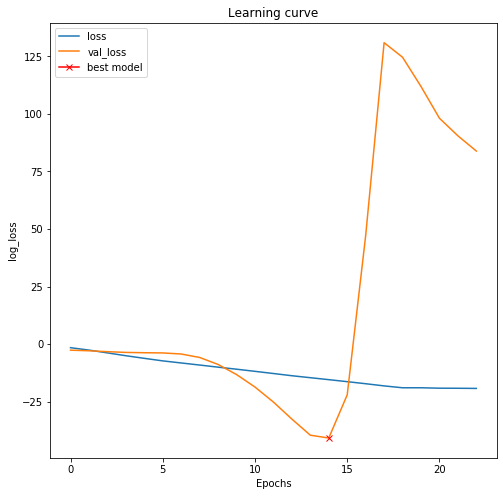

In [30]:
callbacks = [
    EarlyStopping(patience=8, verbose=0),
    ReduceLROnPlateau(factor=0.1, patience=3, min_lr=0.00001, verbose=0),
    ModelCheckpoint('model-drum-15s.h5', verbose=1, save_best_only=True, save_weights_only=True)
]

results = model.fit(X_train, X_test, batch_size=32, epochs=100, callbacks=callbacks,
                     validation_data=(X_train, X_test), verbose=0
                   )

plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend()
plt.savefig('Learning curve.png')




In [31]:
predicted = model.predict(X_test)

In [32]:
predicted.shape

(1, 512, 640, 1)

# Evaluation

Now the model generated its prediction, it's time to see the results:

## Visual Evaluation

Transforming back the samples to be able to analyze them:

In [33]:
X_predicted = predicted.reshape(predicted.shape[1], predicted.shape[2])
X_test = X_test.reshape(X_test.shape[1], X_test.shape[2])
X_train = X_train.reshape(X_train.shape[1], X_train.shape[2])

In [34]:
iterator = iter([str(n) for n in range(100)])


num = next(iterator) 

### Original mix spectrogram

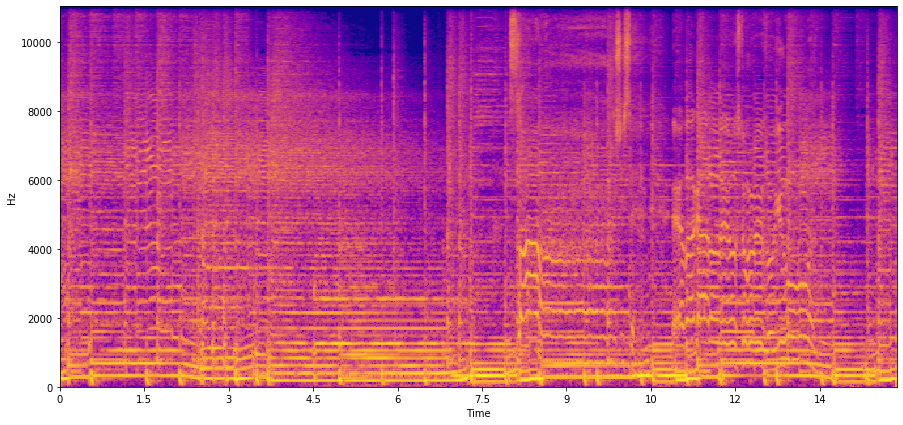

In [35]:
filename = str(num) + 'Train 15s sample.png'

plt.figure(figsize=(15, 7))
librosa.display.specshow(X_train, sr=SR, x_axis='time', y_axis='hz', cmap='plasma')


plt.savefig(filename)


### Instrument spectrogram

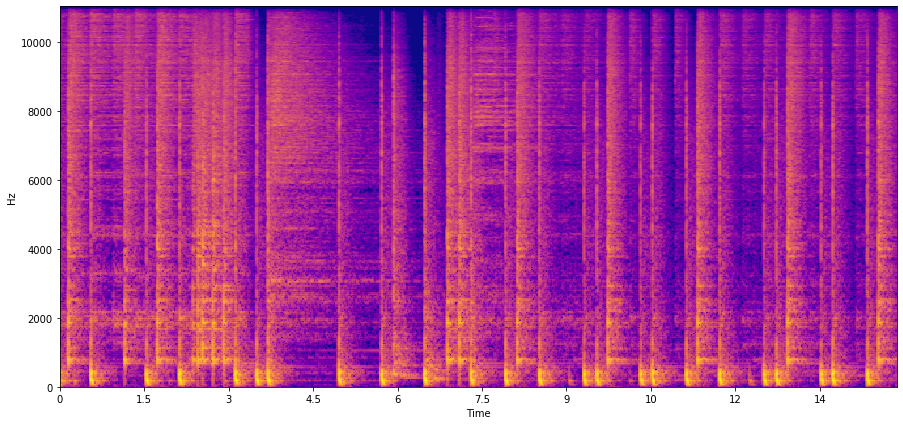

In [36]:
filename = str(num) + 'Test 15s sample.png'


plt.figure(figsize=(15, 7))
librosa.display.specshow(X_test, sr=SR, x_axis='time', y_axis='hz', cmap='plasma')

plt.savefig(filename)


### Our predicted spectrogram

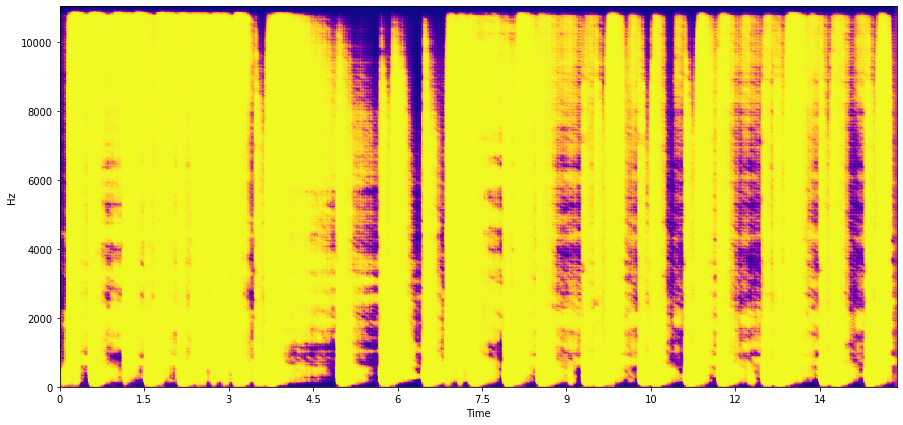

In [37]:
filename = str(num) + 'Predicted 15s sample.png'

plt.figure(figsize=(15, 7))
librosa.display.specshow(X_predicted, sr=SR, x_axis='time', y_axis='hz', cmap='plasma')

plt.savefig('15s_predicted_sample3.png')


Well, it might seem that our model performs quite well! But we're **wrong**.

Our visual perception is tricky. If a pixel is displaced we wouldn't even notice. But, for audio reconstruction, a single pixel implies hundreds of frequencies and intensities, and to our perception, this amout of errors is A LOT!

## Audio evaluation

We'll begin reconstructing our mel-spectrograms into audio signals again:

In [38]:
audio_predicted = mel_to_audio(X_predicted)
audio_train = mel_to_audio(X_train)
audio_test = mel_to_audio(X_test)

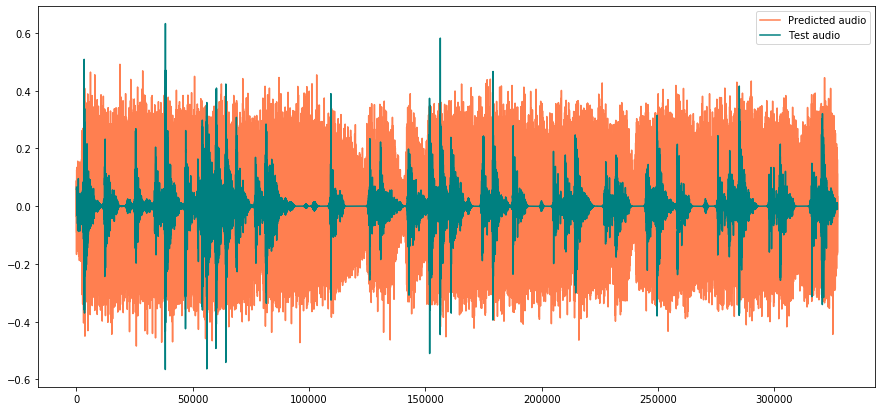

In [39]:
filename = str(num) + 'Waveform comparison sample.png'


plt.figure(figsize=(15,7))
plt.plot(audio_predicted, c='coral')
plt.plot(audio_test, c='teal')
plt.legend(['Predicted audio', 'Test audio'])

plt.savefig(filename)



### Original mix sample

In [40]:
ipd.Audio(audio_train, rate = SR)

### Original test sample

In [41]:
ipd.Audio(audio_test, rate = SR)

### Predicted test sample

In [42]:
number = iter([str(n) for n in range(100)])


filename = str(num) + 'U-Net prediction audio.wav'

librosa.output.write_wav(filename, audio_predicted, SR)

ipd.Audio(audio_predicted, rate=SR)


# Conclusions

Results speak for themselves. Our audio quality is not the desired one. But we'll get there, eventually.

We think we can improve our predictions by:

   - **More accurate spectrograms**. Since they're not perfect on transformation, we'll lose a lot of valuable information on them. Getting spectrograms with a much higher resolution can result in way better audio files.
   - **More samples**. Images are resource intensive, so we'll have to figure a way to be able to train our model with a lot more samples and not die trying.
   - **Better hyperparameter tuning**. Time was an obstacle for this project, so we had to explore the tuning just on the surface. Using techniques like cross validation, pipelines, k_fold etc could lead into better performances.
   - **Model exploring**. Similary, adjusting the structure of the model itself is crucial for better results.
   - **Better spectrogram-to-audio conversion**. The Griffin-lin algorithm for audio reconstruction is a deep and complex mathematical algorithm. We will study it better for a clean application.
   

Thanks for the long-lecture. I hope you enjoyed the trip!
   
       
      

# Resources

[WAVE-U-NET : A multi-scale neural network for end-to-end audio source separation](https://arxiv.org/pdf/1806.03185.pdf)

[Voice separation with deep U-NET Convolutional Networks](https://openaccess.city.ac.uk/id/eprint/19289/1/7bb8d1600fba70dd79408775cd0c37a4ff62.pdf)

[UNet Guide line by line](https://towardsdatascience.com/unet-line-by-line-explanation-9b191c76baf5)

[Segmenting images with Keras](https://www.depends-on-the-definition.com/unet-keras-segmenting-images/)

[Batch normalization in Neural Networks](https://towardsdatascience.com/batch-normalization-in-neural-networks-1ac91516821c)

In [67]:
alive = import_audio_file('/Users/Sosa/Repos/project-final/your-project/Songs/alive/mix.mp3')

ipd.Audio(alive, rate=SR)

In [70]:
section = trim_audio(alive, 30, 45)

ipd.Audio(section, rate=SR)

librosa.output.write_wav('alive mix.wav', section, SR)

